### Dataset

In [ ]:
import requests
from tqdm import tqdm
import os
import csv
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import json
import zipfile
import seaborn as sns
import pandas as pd

In [ ]:
!curl http://www2.ehub.kyoto-u.ac.jp/datasets/macaquepose/macaquepose_v1.zip --output macaquepose_v1.zip
!unzip "/content/macaquepose_v1.zip"

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  inflating: v1/images/ZooA_1130.jpg  
  inflating: v1/images/ZooB_1201.jpg  
  inflating: v1/images/ZooA_0895.jpg  
  inflating: v1/images/ZooC_0804.jpg  
  inflating: v1/images/ZooD_0765.jpg  
  inflating: v1/images/ZooB_0273.jpg  
  inflating: v1/images/ZooB_0196.jpg  
  inflating: v1/images/ZooD_1564.jpg  
  inflating: v1/images/ZooA_1377.jpg  
  inflating: v1/images/ZooD_1509.jpg  
  inflating: v1/images/ZooA_2669.jpg  
  inflating: v1/images/ZooC_1831.jpg  
  inflating: v1/images/ZooD_1150.jpg  
  inflating: v1/images/ZooC_1002.jpg  
  inflating: v1/images/PRI_0136.jpg  
  inflating: v1/images/ZooA_3018.jpg  
  inflating: v1/images/ZooD_0066.jpg  
  inflating: v1/images/ZooA_3054.jpg  
  inflating: v1/images/ZooB_0968.jpg  
  inflating: v1/images/ZooC_1545.jpg  
  inflating: v1/images/ZooA_1287.jpg  
  inflating: v1/images/ZooA_3460.jpg  
  inflating: v1/images/ZooC_2522.jpg  
  inflating: v1/images/Zoo

## EDA

In [ ]:
df = pd.read_csv('/content/v1/annotations.csv')
df

,image file name,keypoinbts,segmentation
0,01418849d54b3005.jpg,"[[{""name"": ""nose"", ""position"": [2337, 1161]}, ...","[[{""segment"":[[172.26,3124.44],[184.14,2863.08..."
1,0142d1d1a6904a70.jpg,"[[{""name"": ""nose"", ""position"": [1317, 1194]}, ...","[[{""segment"":[[1456.89,1350.71],[1490.87,1359...."
2,01ef2c4c260321b7.jpg,"[[{""name"": ""nose"", ""position"": [337, 541]}, {""...","[[{""segment"":[[40.28,988.62],[36.62,970.31],[5..."
3,020a1c75c8c85238.jpg,"[[{""name"": ""nose"", ""position"": [1841.08, 951.7...","[[{""segment"":[[147.29,209.6],[218.1,206.77],[2..."
4,020b1506eef2557d.jpg,"[[{""name"": ""nose"", ""position"": [312, 250]}, {""...","[[{""segment"":[[526.25,340],[506.25,280],[481.2..."
...,...,...,...
13078,ZooD_2457.jpg,"[[{""name"": ""nose"", ""position"": [1669, 932]}, {...","[[{""segment"":[[1153.87,450.56],[1063.21,500.01..."
13079,ZooD_2458.jpg,"[[{""name"": ""nose"", ""position"": null}, {""name"":...","[[{""segment"":[[1545.07,1105.29],[1661.82,1089...."
13080,ZooD_2459.jpg,"[[{""name"": ""nose"", ""position"": [1619, 1294]}, ...","[[{""segment"":[[770.44,1372.58],[708.72,1224.15..."
13081,ZooD_2460.jpg,"[[{""name"": ""nose"", ""position"": null}, {""name"":...","[[{""segment"":[[1409.76,1291.47],[1479.76,1296...."


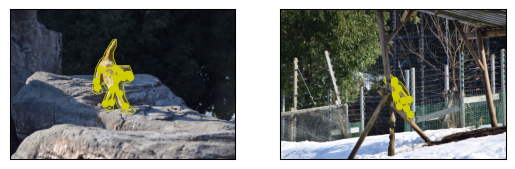

In [ ]:
def drawKp(kp, mrksize, clr, ax):
    cm = plt.get_cmap('hsv', 36)
    kp_con = [{'name':'0_2','color':cm(27), 'bodypart':(0,2)},
            {'name':'0_1','color':cm(31),'bodypart':(0,1)},
            {'name':'2_4','color':cm(29), 'bodypart':(2,4)},
            {'name':'1_3','color':cm(33),'bodypart':(1,3)},
            {'name':'6_8','color':cm(5),'bodypart':(6,8)},
            {'name':'5_7','color':cm(10),'bodypart':(5,7)},
            {'name':'8_10','color':cm(7),'bodypart':(8,10)},
            {'name':'7_9','color':cm(12),'bodypart':(7,9)},
            {'name':'12_14','color':cm(16),'bodypart':(12,14)},
            {'name':'11_13','color':cm(22),'bodypart':(11,13)},
            {'name':'14_16','color':cm(18),'bodypart':(14,16)},
            {'name':'13_15','color':cm(24),'bodypart':(13,15)},
            {'name':'5_6','color':cm(16),'bodypart':(5,6)},
            {'name':'11_12','color':cm(22),'bodypart':(11,12)},
            {'name':'5_11','color':cm(18),'bodypart':(5,11)},
            {'name':'6_12','color':cm(24),'bodypart':(6,12)}]

    for i in reversed(range(len(kp))):
        if kp[i] is not None:
            ax.plot(kp[i][0], kp[i][1], color=clr, marker='o', ms=8*mrksize, alpha=1, markeredgewidth=0)

    for i in reversed(range(len(kp_con))):
        j1 = kp_con[i]['bodypart'][0]
        j2 = kp_con[i]['bodypart'][1]
        if kp[j1] is not None and kp[j2] is not None:
            ax.plot((kp[j1][0], kp[j2][0]), (kp[j1][1], kp[j2][1]), color=clr, ms=0)

def drawSeg(seg, lwid, clr, ax):
    for s in seg:
        poly = np.array(s['segment'], np.float32)
        if len(poly) < 3:
            continue
        p = plt.Polygon(poly, fc = clr, alpha = 0.2)
        ax.add_patch(p)
        p = plt.Polygon(poly, lw = lwid, color=clr, fill=False)
        ax.add_patch(p)

def visualize(n_images=8):
    my_dpi = 96
    C = [(.8, .8, 0),(0, .8, .8),(.8, 0, .8),(0, 1, 0),(0, 0, 1), (1, 0, 0)]

    with open('/content/v1/annotations.csv', 'r') as fp:
        data_annotation = list(csv.reader(fp, delimiter=','))

    fig, axes = plt.subplots(n_images//2, 2, figsize=(640/my_dpi,640/my_dpi),dpi=my_dpi)
    axes = axes.flat
    # print(axes.shape)

    # row = data_annotation[i_image]
    rows = np.random.choice(range(1,len(data_annotation)),replace=False,size=n_images)

    for row_index,row in enumerate(rows):
        # load & draw image
        row = data_annotation[row]
        img = np.asarray(Image.open('/content/v1/images/' + row[0]))
        # print(img.shape)

        ax = axes[row_index]
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(img)

        # load & draw keypoint
        kp_string= row[1]
        Kp = json.loads(kp_string)
        for i_monkey, kp in enumerate(Kp):
            kp2 = []
            for p in kp:
                kp2.append(p['position'])
            drawKp(kp2, 0.7, C[i_monkey%6], ax)

        # load & draw segmentation
        seg_string= row[2]
        Seg = json.loads(seg_string)

        for i_monkey, seg in enumerate(Seg):
            drawSeg(seg, 0.5, C[i_monkey%6], ax)

    # plt.axis('off')
    plt.show()

# the input number = image index
visualize(n_images=2)

In [ ]:
tqdm.pandas()
def parse_keypoints(keypoint):
  data = json.loads(keypoint)
  return np.array(data)

df['keypoints'] = df['keypoinbts'].progress_apply(parse_keypoints)

100%|██████████| 13083/13083 [00:00<00:00, 16111.99it/s]


In [ ]:
df['keypoints'][20]

array([[{'name': 'nose', 'position': [1360, 1321]},
        {'name': 'left eye', 'position': [1471, 1403]},
        {'name': 'right eye', 'position': [1500, 1305]},
        {'name': 'left ear', 'position': None},
        {'name': 'right ear', 'position': [1678, 1195]},
        {'name': 'left shoulder', 'position': [1750, 1354]},
        {'name': 'right shoulder', 'position': [1574, 1030]},
        {'name': 'left elbow', 'position': [1304, 1234]},
        {'name': 'right elbow', 'position': [1566, 773]},
        {'name': 'left wrist', 'position': [961, 1205]},
        {'name': 'right wrist', 'position': [1218, 1057]},
        {'name': 'left hip', 'position': None},
        {'name': 'right hip', 'position': [1860, 797.5]},
        {'name': 'left knee', 'position': None},
        {'name': 'right knee', 'position': [1546, 836]},
        {'name': 'left ankle', 'position': None},
        {'name': 'right ankle', 'position': [1190, 925]}],
       [{'name': 'nose', 'position': [926, 1029]},
   

In [ ]:
df['keypoints'][20].shape

(4, 17)

In [ ]:
def img_size(img_path):
  img = np.asarray(Image.open('/content/v1/images/' + img_path))
  return img.shape

df['image size'] = df['image file name'].progress_apply(img_size)
df

100%|██████████| 13083/13083 [11:33<00:00, 18.87it/s]


,image file name,keypoinbts,segmentation,keypoints,image size
0,01418849d54b3005.jpg,"[[{""name"": ""nose"", ""position"": [2337, 1161]}, ...","[[{""segment"":[[172.26,3124.44],[184.14,2863.08...","[[{'name': 'nose', 'position': [2337, 1161]}, ...","(3168, 4752, 3)"
1,0142d1d1a6904a70.jpg,"[[{""name"": ""nose"", ""position"": [1317, 1194]}, ...","[[{""segment"":[[1456.89,1350.71],[1490.87,1359....","[[{'name': 'nose', 'position': [1317, 1194]}, ...","(2276, 3399, 3)"
2,01ef2c4c260321b7.jpg,"[[{""name"": ""nose"", ""position"": [337, 541]}, {""...","[[{""segment"":[[40.28,988.62],[36.62,970.31],[5...","[[{'name': 'nose', 'position': [337, 541]}, {'...","(1264, 1089, 3)"
3,020a1c75c8c85238.jpg,"[[{""name"": ""nose"", ""position"": [1841.08, 951.7...","[[{""segment"":[[147.29,209.6],[218.1,206.77],[2...","[[{'name': 'nose', 'position': [1841.08, 951.7...","(2737, 3221, 3)"
4,020b1506eef2557d.jpg,"[[{""name"": ""nose"", ""position"": [312, 250]}, {""...","[[{""segment"":[[526.25,340],[506.25,280],[481.2...","[[{'name': 'nose', 'position': [312, 250]}, {'...","(667, 1000, 3)"
...,...,...,...,...,...
13078,ZooD_2457.jpg,"[[{""name"": ""nose"", ""position"": [1669, 932]}, {...","[[{""segment"":[[1153.87,450.56],[1063.21,500.01...","[[{'name': 'nose', 'position': [1669, 932]}, {...","(2000, 2992, 3)"
13079,ZooD_2458.jpg,"[[{""name"": ""nose"", ""position"": null}, {""name"":...","[[{""segment"":[[1545.07,1105.29],[1661.82,1089....","[[{'name': 'nose', 'position': None}, {'name':...","(2000, 2992, 3)"
13080,ZooD_2459.jpg,"[[{""name"": ""nose"", ""position"": [1619, 1294]}, ...","[[{""segment"":[[770.44,1372.58],[708.72,1224.15...","[[{'name': 'nose', 'position': [1619, 1294]}, ...","(2000, 2992, 3)"
13081,ZooD_2460.jpg,"[[{""name"": ""nose"", ""position"": null}, {""name"":...","[[{""segment"":[[1409.76,1291.47],[1479.76,1296....","[[{'name': 'nose', 'position': None}, {'name':...","(2000, 2992, 3)"


$$$$

**Number of keypoints per category that are labeled**

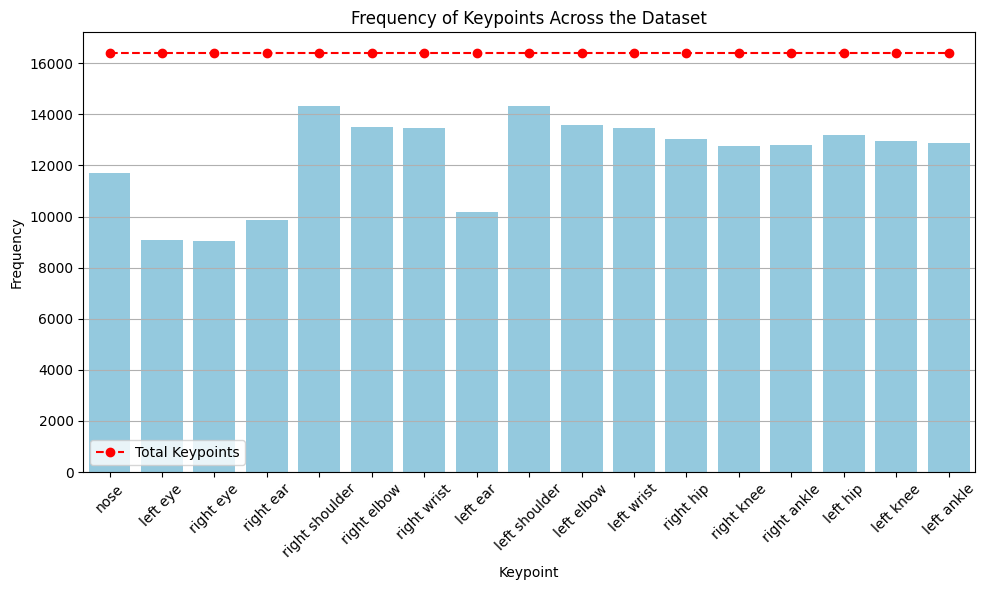

In [ ]:
plt.style.use('default')

# Extract keypoint names
# Count the occurrences of each keypoint, considering None values
keypoint_counts = {}
keypoints_none = {}
keypoints_total = {}
for keypoints in df['keypoints']: # groupe de points
    for bodyposition in keypoints:
      for point in bodyposition:
          name = point['name']
          keypoints_total[name] = keypoints_total.get(name, 0) + 1
          if point['position'] is not None:
              keypoint_counts[name] = keypoint_counts.get(name, 0) + 1
          else:
            keypoints_none[name] = keypoints_none.get(name, 0) + 1


total_keypoints = [keypoints_total[key] for key in keypoint_counts.keys()]
plt.figure(figsize=(10, 6))
plt.plot(total_keypoints, color='red', linestyle='--', marker='o', label='Total Keypoints')
sns.barplot(x=list(keypoint_counts.keys()), y=list(keypoint_counts.values()), color='skyblue')
plt.xlabel('Keypoint')
plt.ylabel('Frequency')
plt.title('Frequency of Keypoints Across the Dataset')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.tight_layout()
plt.show()

**Distribution of images sizes**

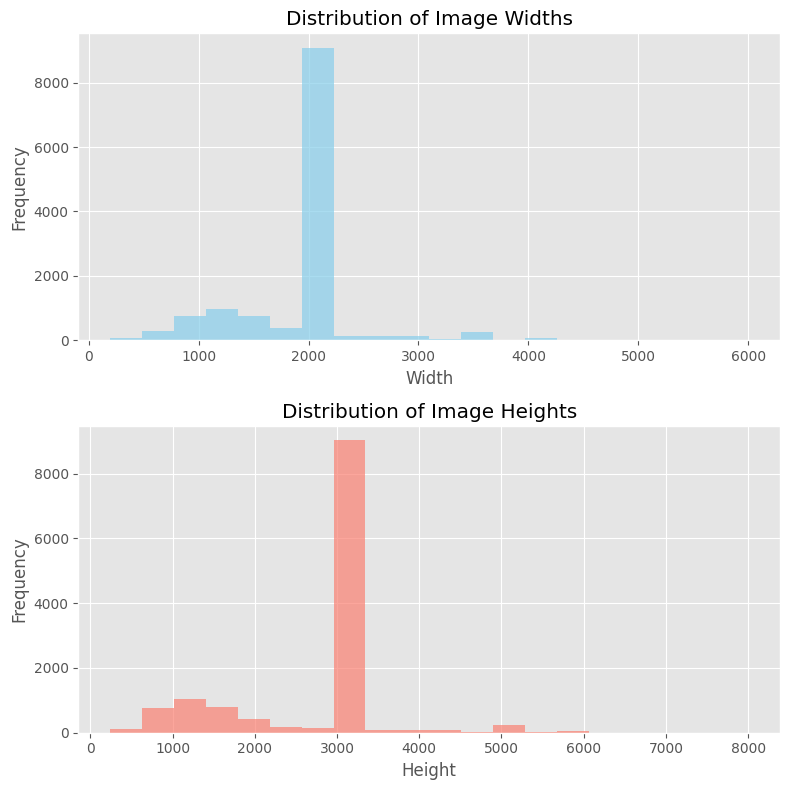

In [ ]:
plt.style.use('ggplot')
sizes = df['image size'].tolist()

# Extract width and height separately
widths = [size[0] for size in sizes]
heights = [size[1] for size in sizes]

# Create a figure with subplots for width and height histograms
fig, axes = plt.subplots(2, 1, figsize=(8, 8))

# Plot histogram for widths
axes[0].hist(widths, bins=20, color='skyblue', alpha=0.7)
axes[0].set_title('Distribution of Image Widths')
axes[0].set_xlabel('Width')
axes[0].set_ylabel('Frequency')

# Plot histogram for heights
axes[1].hist(heights, bins=20, color='salmon', alpha=0.7)
axes[1].set_title('Distribution of Image Heights')
axes[1].set_xlabel('Height')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

**Keypoints Distribution**

In [ ]:
def create_normalized_df(df):
    normalized_data = []
    for index, row in tqdm(df.iterrows()):
        img_shape = row['image size']
        width, height = img_shape[1], img_shape[0]

        for keypoints in row['keypoints']:
              for point in keypoints:
                  name = point['name']
                  if point['position'] is not None:
                    x, y = point['position']
                    # Normalize x and y positions
                    normalized_x = x / width
                    normalized_y = y / height

                    # Append normalized data to list
                    normalized_data.append({'Normalized_X': normalized_x, 'Normalized_Y': normalized_y,'Name': name})

    # Create DataFrame from normalized data
    normalized_df = pd.DataFrame(normalized_data)
    return normalized_df

# Example usage
position_df = create_normalized_df(df)
position_df

13083it [00:00, 18521.67it/s]


,Normalized_X,Normalized_Y,Name
0,0.491793,0.366477,nose
1,0.414983,0.288194,left eye
2,0.368750,0.322500,right eye
3,0.216120,0.528725,right ear
4,0.323232,0.845960,right shoulder
...,...,...,...
210139,0.533422,0.524500,right hip
210140,0.444602,0.600760,left knee
210141,0.489973,0.563500,right knee
210142,0.466116,0.701905,left ankle


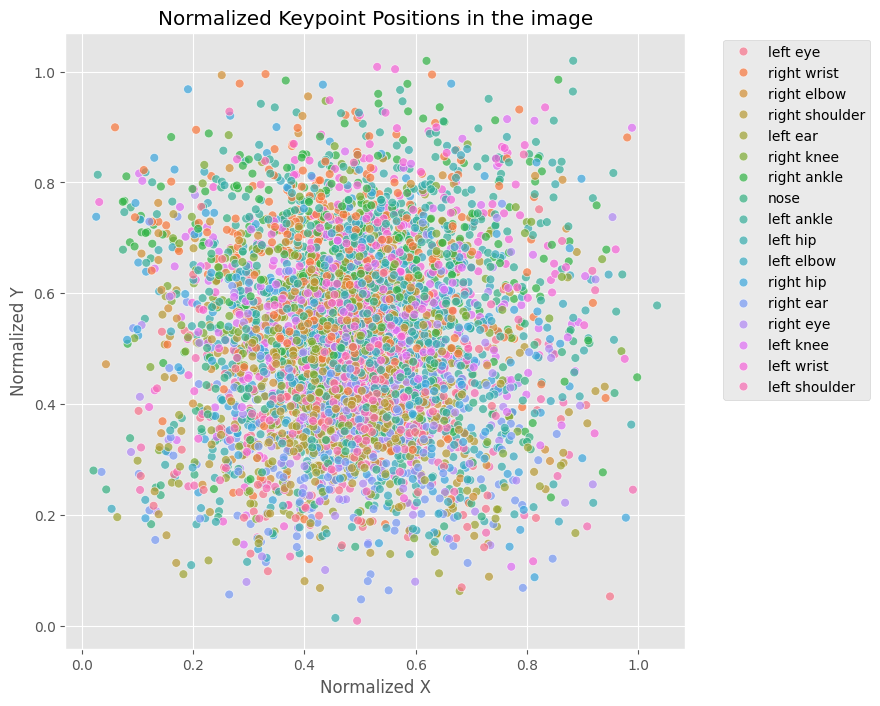

In [ ]:
plt.style.use('ggplot')
plt.figure(figsize=(8, 8))
sns.scatterplot(data=position_df.sample(5000), x='Normalized_X', y='Normalized_Y', hue='Name', palette=sns.color_palette("husl", 17)
, s=40,alpha=0.7)
plt.title('Normalized Keypoint Positions in the image')
plt.xlabel('Normalized X')
plt.ylabel('Normalized Y')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

$$$$

## YOLOv8 annotations

In [ ]:
from shutil import copy

In [ ]:
def find_bounding_box(segmentation):
    min_x = min(point[0] for point in segmentation)
    max_x = max(point[0] for point in segmentation)
    min_y = min(point[1] for point in segmentation)
    max_y = max(point[1] for point in segmentation)
    return min_x, min_y, max_x, max_y

In [ ]:
# plt.style.use('default')
# row = "ZooA_2170.jpg"
# row_index = 13
# row = data_annotation[row_index]
# img = np.asarray(Image.open('/content/v1/images/' + row))
# print(img.shape)
# my_dpi = 96
# fig, ax = plt.subplots(figsize=(640/my_dpi, 640/my_dpi), dpi=my_dpi)
# segment = json.loads(row[2])

# # plot keypoints
# Kp = json.loads(row[1])
# kp2 = []
# for kp in Kp:
#         for p in kp:
#             kp2.append(p['position'])
# for i in reversed(range(len(kp2))):
#         if kp2[i] is not None:
#             ax.plot(kp2[i][0], kp2[i][1], color=(0.8, 0, 0.8), marker='o', ms=8*0.7, alpha=1, markeredgewidth=0)

# # plot bbox
# for s in segment:
#   s = s[0]['segment']
#   min_x, min_y, max_x, max_y = find_bounding_box(s)
#   rect = plt.Rectangle((min_x, min_y), max_x - min_x, max_y - min_y, linewidth=2, edgecolor='r', facecolor='none')
#   ax.add_patch(rect)

# ax.imshow(img)
# plt.show()

In [ ]:
# tem_df = tem_df[tem_df['num_individuals']>2]
# tem_df

**Image example for Yolov8 annotations**

In [ ]:
# df

In [ ]:
df[df['image file name'] == '41f41d2862619f01.jpg'].index

Index([325], dtype='int64')

py: 1.0050236406619386 name= left hip img_height=3384 py=3401
py: 1.0319148936170213 name= left ankle img_height=3384 py=3492
py: 1.0195035460992907 name= right ankle img_height=3384 py=3450
py: 1.0159574468085106 name= right ankle img_height=3384 py=3438


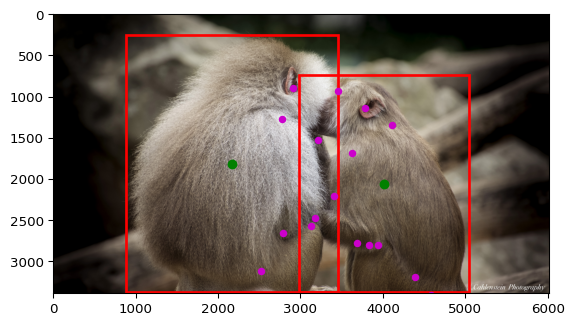

In [ ]:
plt.style.use('default')
my_dpi = 96
fig, ax = plt.subplots(figsize=(640/my_dpi, 640/my_dpi), dpi=my_dpi)

row = df.iloc[325]

# image
img_path = row['image file name'] # name of the txt file
img = np.asarray(Image.open('/content/v1/images/' + img_path))
img_path = img_path.replace('.jpg','')
output_filename = os.path.join(img_path + '.txt')
# size of the image
height, width, _ = row['image size']

# plot bbox
segment = row['segmentation']
segment = json.loads(segment)
Kp = row['keypoints']
if Kp.shape[0] == len(segment):
  pass
else:
  raise ValueError('Shape Mismatch')

with open(output_filename, 'w') as output_file:

    for s,kp in zip(segment,Kp):
      s = s[0]['segment']
      min_x, min_y, max_x, max_y = find_bounding_box(s)

      # normalise the coords
      w = max_x - min_x
      h = max_y - min_y
      w = w / width
      h = h / height

      # detremine the center of the bbox
      center_x = (min_x + max_x) / 2
      center_y = (min_y + max_y) / 2
      # normalise the center
      center_x_normalised = center_x / width
      center_y_normalised = center_y / height

      # write to file
      output_file.write(f'{0} {center_x_normalised} {center_y_normalised} {w} {h}')

      # plot the coords
      rect = plt.Rectangle((min_x, min_y), max_x - min_x, max_y - min_y, linewidth=2, edgecolor='r', facecolor='none')
      ax.add_patch(rect)
      ax.scatter(center_x, center_y, color='green', marker='o', s=40)

      for p in kp:
              name = p['name']
              p = p['position']

              if p is not None:
                  px = p[0] / width
                  py = p[1] / height
                  if px >= 1:
                    print(f'px: {px} name= {name} img_width={img.shape[1]} px={p[0]}')
                  if py >= 1:
                     print(f'py: {py} name= {name} img_height={img.shape[0]} py={p[1]}')
                  output_file.write(f" {px} {py} {2.0}")
                  # plot keypoints
                  ax.plot(p[0], p[1], color=(0.8, 0, 0.8), marker='o', ms=8*0.7, alpha=1, markeredgewidth=0)
              else:
                output_file.write(" 0.0 0.0 0.0")


      output_file.write("\n")

ax.imshow(img)
plt.show()

$$$$

**Draw keypoints and bbox**

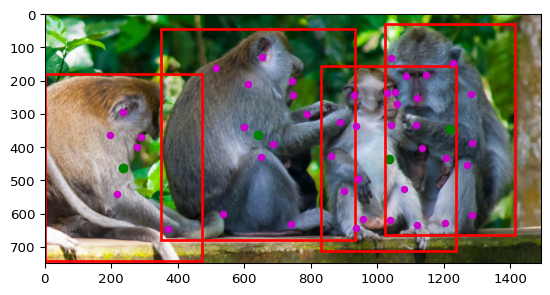

In [ ]:
plt.style.use('default')
my_dpi = 96
fig, ax = plt.subplots(figsize=(640/my_dpi, 640/my_dpi), dpi=my_dpi)

row = df.iloc[13]

# image
img_path = row['image file name'] # name of the txt file
img = np.asarray(Image.open('/content/v1/images/' + img_path))
img_path = img_path.replace('.jpg','')
output_filename = os.path.join(img_path + '.txt')
# size of the image
height, width, _ = row['image size']

# plot bbox
segment = row['segmentation']
segment = json.loads(segment)
Kp = row['keypoints']
if Kp.shape[0] == len(segment):
  pass
else:
  raise ValueError('Shape Mismatch')

with open(output_filename, 'w') as output_file:

    for s,kp in zip(segment,Kp):
      s = s[0]['segment']
      min_x, min_y, max_x, max_y = find_bounding_box(s)

      # normalise the coords
      w = max_x - min_x
      h = max_y - min_y
      w = w / width
      h = h / height

      # detremine the center of the bbox
      center_x = (min_x + max_x) / 2
      center_y = (min_y + max_y) / 2
      # normalise the center
      center_x_normalised = center_x / width
      center_y_normalised = center_y / height

      # write to file
      output_file.write(f'{0} {center_x_normalised} {center_y_normalised} {w} {h}')

      # plot the coords
      rect = plt.Rectangle((min_x, min_y), max_x - min_x, max_y - min_y, linewidth=2, edgecolor='r', facecolor='none')
      ax.add_patch(rect)
      ax.scatter(center_x, center_y, color='green', marker='o', s=40)

      for p in kp:
              p = p['position']
              if p is not None:
                  px = p[0] / width
                  py = p[1] / height
                  output_file.write(f" {px} {py} {2.0}")
                  # plot keypoints
                  ax.plot(p[0], p[1], color=(0.8, 0, 0.8), marker='o', ms=8*0.7, alpha=1, markeredgewidth=0)
              else:
                output_file.write(" 0.0 0.0 0.0")


      output_file.write("\n")

ax.imshow(img)
plt.show()

**Verification**

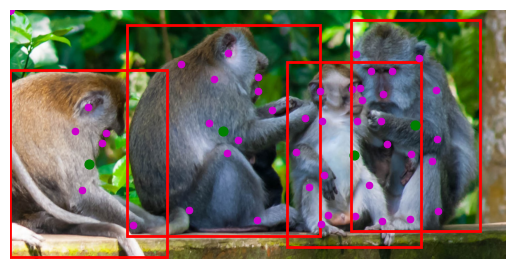

In [ ]:
# Function to parse YOLOv8 Pose annotations
def parse_yolov8_pose_annotations(annotation_file):
    with open(annotation_file, 'r') as file:
        lines = file.readlines()

    annotations = []
    for line in lines:
        line = line.strip().split()
        class_id = int(line[0])
        bbox_center_x = float(line[1])
        bbox_center_y = float(line[2])
        bbox_width = float(line[3])
        bbox_height = float(line[4])
        keypoints = [(float(line[i]), float(line[i+1]), float(line[i+2])) for i in range(5, len(line), 3)]
        annotations.append({'class_id': class_id, 'bbox_center_x': bbox_center_x, 'bbox_center_y': bbox_center_y,
                            'bbox_width': bbox_width, 'bbox_height': bbox_height, 'keypoints': keypoints})

    return annotations

# Function to plot image with annotations
def plot_image_with_annotations(image, annotations):
    plt.imshow(image)
    for annotation in annotations:
        bbox_center_x = annotation['bbox_center_x'] * image.shape[1]
        bbox_center_y = annotation['bbox_center_y'] * image.shape[0]
        bbox_width = annotation['bbox_width'] * image.shape[1]
        bbox_height = annotation['bbox_height'] * image.shape[0]
        bbox_x = bbox_center_x - bbox_width / 2
        bbox_y = bbox_center_y - bbox_height / 2
        # draw center
        plt.scatter(bbox_center_x, bbox_center_y, color='green', marker='o', s=40)
        # draw rectangle
        bbox_rect = plt.Rectangle((bbox_x, bbox_y), bbox_width, bbox_height, linewidth=2, edgecolor='r', facecolor='none')
        plt.gca().add_patch(bbox_rect)
        # draw keypoints
        for keypoint in annotation['keypoints']:
            keypoint_x = keypoint[0] * image.shape[1]
            keypoint_y = keypoint[1] * image.shape[0]
            plt.scatter(keypoint_x, keypoint_y, color=(0.8, 0, 0.8), marker='o', s=20)
    plt.axis('off')
    plt.show()


annotation_file = output_filename
annotations = parse_yolov8_pose_annotations(annotation_file)
plot_image_with_annotations(img, annotations)


$$$$

**Create Directories**

In [ ]:
!rm -rf /content/animal-pose-data
DATA_DIR = "animal-pose-data"

TRAIN_DIR         = f"train"
TRAIN_FOLDER_IMG    = f"images"
TRAIN_FOLDER_LABELS = f"labels"
TRAIN_IMG_PATH   = os.path.join(DATA_DIR, TRAIN_DIR, TRAIN_FOLDER_IMG)
TRAIN_LABEL_PATH = os.path.join(DATA_DIR, TRAIN_DIR, TRAIN_FOLDER_LABELS)
os.makedirs(TRAIN_IMG_PATH, exist_ok=True)
os.makedirs(TRAIN_LABEL_PATH, exist_ok=True)

VALID_DIR           = f"valid"
VALID_FOLDER_IMG    = f"images"
VALID_FOLDER_LABELS = f"labels"
VALID_IMG_PATH   = os.path.join(DATA_DIR, VALID_DIR, VALID_FOLDER_IMG)
VALID_LABEL_PATH = os.path.join(DATA_DIR, VALID_DIR, VALID_FOLDER_LABELS)
os.makedirs(VALID_IMG_PATH, exist_ok=True)
os.makedirs(VALID_LABEL_PATH, exist_ok=True)

TEST_DIR           = f"test"
TEST_FOLDER_IMG    = f"images"
TEST_FOLDER_LABELS = f"labels"
TEST_IMG_PATH   = os.path.join(DATA_DIR, TEST_DIR, TEST_FOLDER_IMG)
TEST_LABEL_PATH = os.path.join(DATA_DIR, TEST_DIR, TEST_FOLDER_LABELS)
os.makedirs(TEST_IMG_PATH, exist_ok=True)
os.makedirs(TEST_LABEL_PATH, exist_ok=True)

**Train Test Split**

In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train (80%) and temp (20%)
train_df, temp_df = train_test_split(df, test_size=0.2, random_state=42)

# Split the temp DataFrame into validation (50%) and test (50%)
valid_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42)
print(f'Train size: {train_df.shape}')
print(f'Val size: {valid_df.shape}')
print(f'Test size: {test_df.shape}')

Train size: (10466, 5)
Val size: (1308, 5)
Test size: (1309, 5)


**Copy images to appropriate Folder**

In [ ]:
# Copy images for the test set
for index, row in tqdm(test_df.iterrows()):
    image_name = row['image file name']
    copy(os.path.join('/content/v1/images', image_name),
         os.path.join('/content/animal-pose-data/test/images', image_name))

len(os.listdir('/content/animal-pose-data/test/images'))

1309it [00:20, 64.86it/s]


1309

In [ ]:
# Copy images for the validation set
for index, row in tqdm(valid_df.iterrows()):
    image_name = row['image file name']
    copy(os.path.join('/content/v1/images', image_name),
         os.path.join('/content/animal-pose-data/valid/images', image_name))

len(os.listdir('/content/animal-pose-data/valid/images'))

1308it [00:20, 63.82it/s]


1308

In [ ]:
# Copy images for the train set
for index, row in tqdm(train_df.iterrows()):
    image_name = row['image file name']
    copy(os.path.join('/content/v1/images', image_name),
         os.path.join('/content/animal-pose-data/train/images', image_name))

len(os.listdir('/content/animal-pose-data/train/images'))

10466it [02:43, 63.96it/s]


10466

**Make annotations**

In [ ]:
def yolodata(df=train_df,split='train'):
  for _, row in tqdm(df.iterrows(),desc=f'{split}: '):
    # image
    img_path = row['image file name'] # name of the txt file
    img_path = os.path.splitext(os.path.basename(img_path))[0]

    output_filename = os.path.join(f'/content/animal-pose-data/{split}/labels',img_path + '.txt')
    # size of the image
    height, width,_ = row['image size']

    segment = row['segmentation']
    segment = json.loads(segment)
    Kp = row['keypoints']

    if Kp.shape[0] == len(segment):
      pass
    else:
      print(img_path)
      continue

    with open(output_filename, 'w') as output_file:

        for s,kp in zip(segment,Kp):
          s = s[0]['segment']
          min_x, min_y, max_x, max_y = find_bounding_box(s)

          # normalise the coords
          w = max_x - min_x
          h = max_y - min_y
          w = w / width
          h = h / height

          # detremine the center of the bbox
          center_x = (min_x + max_x) / 2
          center_y = (min_y + max_y) / 2
          # normalise the center
          center_x_normalised = center_x / width
          center_y_normalised = center_y / height

          # write to file
          output_file.write(f'{0} {center_x_normalised} {center_y_normalised} {w} {h}')

          for p in kp:
                  p = p['position']
                  if p is not None:
                      px = p[0] / width
                      py = p[1] / height
                      output_file.write(f" {px} {py} {2.0}")
                  else:
                    output_file.write(" 0.0 0.0 0.0")
          output_file.write("\n")

In [ ]:
yolodata(df=train_df,split='train')
yolodata(df=valid_df,split='valid')
yolodata(df=test_df,split='test')

train: : 10466it [00:02, 3818.81it/s]
valid: : 1308it [00:00, 3774.32it/s]
test: : 1309it [00:00, 3845.08it/s]


$$$$

## Train Model

In [ ]:
!pip install --quiet ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 910.4/910.4 kB 21.5 MB/s eta 0:00:00


In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.64 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 89.4/112.6 GB disk)


In [ ]:
## connecting to the google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import yaml

yaml_str = """
####
# Train/val/test sets as
path: /content/animal-pose-data # dataset root dir
train: train/images # train images (relative to 'path') 118287 images
val: valid/images # val images (relative to 'path') 5000 images
# test: test-dev2017.txt #

# Keypoints
kpt_shape: [17, 3] # number of keypoints, number of dims (2 for x,y or 3 for x,y,visible)
# flip_idx: [0, 2, 1, 4, 3, 6, 5, 8, 7, 10, 9, 12, 11, 14, 13, 16, 15]

# Classes
names:
  0: macaque
"""

# Write YAML string to a file
with open('config.yaml', 'w') as yaml_file:
    yaml_file.write(yaml_str)


In [ ]:
from ultralytics import YOLO
model = YOLO("/yolov8s-pose.pt")

100%|██████████| 22.4M/22.4M [00:00<00:00, 111MB/s] 


In [ ]:
model.train(data='/content/config.yaml',epochs=3, imgsz=640, name='/content/drive/MyDrive/yolov8s_macaques')

Ultralytics 8.3.64 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=pose, mode=train, model=/yolov8s-pose.pt, data=/content/config.yaml, epochs=3, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8s_macaques2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, s

100%|██████████| 755k/755k [00:00<00:00, 20.1MB/s]



                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256

100%|██████████| 5.35M/5.35M [00:00<00:00, 100MB/s]


AMP: checks passed ✅


train: Scanning /content/animal-pose-data/train/labels... 10466 images, 0 backgrounds, 67 corrupt: 100%|██████████| 10466/10466 [00:27<00:00, 379.79it/s]

train: WARNING ⚠️ /content/animal-pose-data/train/images/36733cdb5f4af01e.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0026]
train: WARNING ⚠️ /content/animal-pose-data/train/images/369164910eb3151b.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0295]
train: WARNING ⚠️ /content/animal-pose-data/train/images/41f41d2862619f01.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [      1.005      1.0319      1.0195       1.016]
train: WARNING ⚠️ /content/animal-pose-data/train/images/4dcf210b4377dc52.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0019]
train: WARNING ⚠️ /content/animal-pose-data/train/images/62a9c3eb96333691.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0444]
train: WARNING ⚠️ /content/animal-pose-data/train/images/6b5dd31eb57262b4.jpg: ignoring corrupt image/label: non-normalized or ou

train: New cache created: /content/animal-pose-data/train/labels.cache
WARNING ⚠️ No 'flip_idx' array defined in data.yaml, setting augmentation 'fliplr=0.0'
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.0 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/animal-pose-data/valid/labels... 1308 images, 0 backgrounds, 13 corrupt: 100%|██████████| 1308/1308 [00:04<00:00, 311.54it/s]

val: WARNING ⚠️ /content/animal-pose-data/valid/images/01418849d54b3005.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0369]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/0c58303601bfe7c9.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.1116]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/0d4eb82a2d639d39.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0292]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/ZooA_0185.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0055]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/ZooA_1026.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [      1.087]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/ZooA_1607.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0515]
val: WARNING ⚠️ /content/animal

Plotting labels to /content/drive/MyDrive/yolov8s_macaques2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 63 weight(decay=0.0), 73 weight(decay=0.0005), 72 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/yolov8s_macaques2
Starting training for 3 epochs...

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


        1/3      4.05G     0.9565      4.506     0.4296      0.763      1.234         38        640: 100%|██████████| 650/650 [10:33<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 41/41 [00:56<00:00,  1.38s/it]


                   all       1295       1631      0.823      0.783      0.871      0.624      0.671      0.578      0.544      0.142

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


        2/3      4.06G       0.96      4.366     0.4075     0.7311      1.225         43        640: 100%|██████████| 650/650 [10:51<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 41/41 [00:58<00:00,  1.42s/it]


                   all       1295       1631       0.92      0.918       0.95      0.734       0.81      0.749      0.728      0.237

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


        3/3      4.23G     0.8517      3.676     0.3784      0.623      1.157         42        640: 100%|██████████| 650/650 [10:47<00:00,  1.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 41/41 [00:59<00:00,  1.44s/it]

                   all       1295       1631      0.945      0.933      0.961      0.799      0.891      0.839       0.84      0.391



3 epochs completed in 0.593 hours.
Optimizer stripped from /content/drive/MyDrive/yolov8s_macaques2/weights/last.pt, 23.5MB
Optimizer stripped from /content/drive/MyDrive/yolov8s_macaques2/weights/best.pt, 23.5MB

Validating /content/drive/MyDrive/yolov8s_macaques2/weights/best.pt...
Ultralytics 8.3.64 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-pose summary (fused): 187 layers, 11,615,724 parameters, 0 gradients, 30.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 41/41 [01:17<00:00,  1.90s/it]


                   all       1295       1631      0.945      0.933      0.961      0.799      0.891      0.838      0.839      0.391
Speed: 0.2ms preprocess, 3.9ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to /content/drive/MyDrive/yolov8s_macaques2


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a707878ed10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    

**Validate Model**

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/yolov8s_macaques2

<IPython.core.display.Javascript object>

In [ ]:
res = model.val()

Ultralytics 8.3.64 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-pose summary (fused): 187 layers, 11,615,724 parameters, 0 gradients, 30.2 GFLOPs


val: Scanning /content/animal-pose-data/valid/labels.cache... 1308 images, 0 backgrounds, 13 corrupt: 100%|██████████| 1308/1308 [00:00<?, ?it/s]

val: WARNING ⚠️ /content/animal-pose-data/valid/images/01418849d54b3005.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0369]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/0c58303601bfe7c9.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.1116]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/0d4eb82a2d639d39.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0292]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/ZooA_0185.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0055]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/ZooA_1026.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [      1.087]
val: WARNING ⚠️ /content/animal-pose-data/valid/images/ZooA_1607.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0515]
val: WARNING ⚠️ /content/animal


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 81/81 [01:39<00:00,  1.23s/it]


                   all       1295       1631      0.946      0.931      0.961      0.798      0.889       0.84      0.839      0.391
Speed: 0.3ms preprocess, 8.5ms inference, 0.0ms loss, 2.8ms postprocess per image
Results saved to runs/pose/yolov8s_macaques2


**Prediction**

In [ ]:
model = YOLO("/content/drive/MyDrive/yolov8s_macaques2/weights/best.pt")

In [ ]:
result = model.predict("/content/animal-pose-data/test/images/0273940a0c1057ef.jpg" , save = True , save_txt = True,conf=0.4)


image 1/1 /content/animal-pose-data/test/images/0273940a0c1057ef.jpg: 480x640 3 macaques, 51.5ms
Speed: 3.2ms preprocess, 51.5ms inference, 23.9ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/pose/predict
1 label saved to runs/pose/predict/labels


In [ ]:
result

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: ultralytics.engine.results.Keypoints object
 masks: None
 names: {0: 'macaque'}
 obb: None
 orig_img: array([[[ 96, 113, 140],
         [100, 117, 144],
         [104, 121, 147],
         ...,
         [126, 138, 162],
         [125, 136, 158],
         [119, 130, 150]],
 
        [[100, 117, 144],
         [102, 119, 146],
         [105, 122, 148],
         ...,
         [126, 136, 160],
         [124, 135, 157],
         [119, 130, 150]],
 
        [[100, 117, 144],
         [102, 119, 146],
         [104, 121, 148],
         ...,
         [127, 135, 158],
         [127, 136, 156],
         [123, 132, 152]],
 
        ...,
 
        [[ 90, 107, 140],
         [ 94, 111, 144],
         [ 96, 114, 145],
         ...,
         [ 91, 102, 124],
         [ 84,  91, 116],
         [ 78,  86, 109]],
 
        [[ 96, 107, 137],
         [ 99, 110, 140],
         [ 97, 109

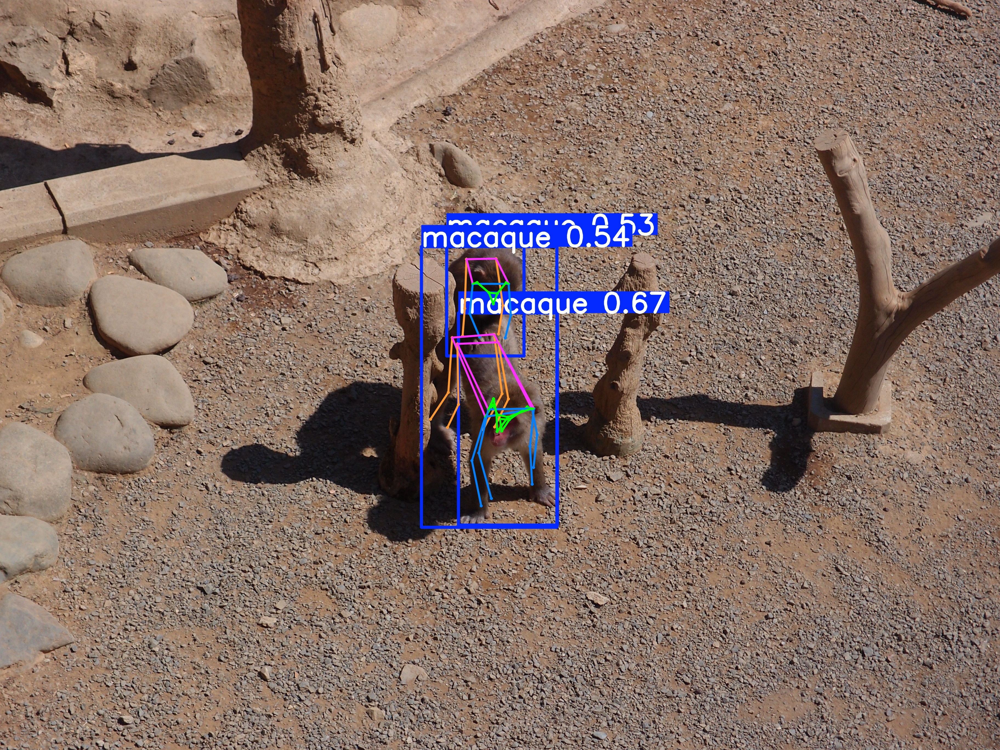

In [ ]:
Image.open('/content/runs/pose/predict/0273940a0c1057ef.jpg')

In [ ]:
file_name = "/content/drive/MyDrive/yolov8s_macaques2/weights/best.pt"

file_stats = os.stat(file_name)

print(file_stats)
print(f'File Size in Bytes is {file_stats.st_size}')
print(f'File Size in MegaBytes is {file_stats.st_size / (1024 * 1024)}')

os.stat_result(st_mode=33152, st_ino=218, st_dev=87, st_nlink=1, st_uid=0, st_gid=0, st_size=23491281, st_atime=1737386487, st_mtime=1737386479, st_ctime=1737386753)
File Size in Bytes is 23491281
File Size in MegaBytes is 22.40303134918213


$$$$